<a href="https://colab.research.google.com/github/yashasree287/Vehicle-Counting-Case-Study/blob/main/Vehicle%20Detection%20and%20Counting.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import warnings
warnings.filterwarnings('ignore')
!pip install ultralytics
# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import yaml
from PIL import Image
from ultralytics import YOLO
from IPython.display import Video

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.0/887.0 kB 15.2 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
# Configure the visual appearance of seaborn plots
sns.set(rc={'axes.facecolor': '#eae8fa'}, style='darkgrid')

In [ ]:
# Loading YOLO Pretrained model
model = YOLO('yolov8n.pt')

100%|██████████| 6.25M/6.25M [00:00<00:00, 73.0MB/s]


In [ ]:
import zipfile
import os

file_name = "/content/drive/MyDrive/Untitled folder/archive (2).zip"  # Replace with the name of your uploaded ZIP file

with zipfile.ZipFile(file_name, 'r') as zip_ref:
    zip_ref.extractall("extracted_folder")  # Specify the folder where files will be extracted
    print("Files extracted successfully!")

Files extracted successfully!


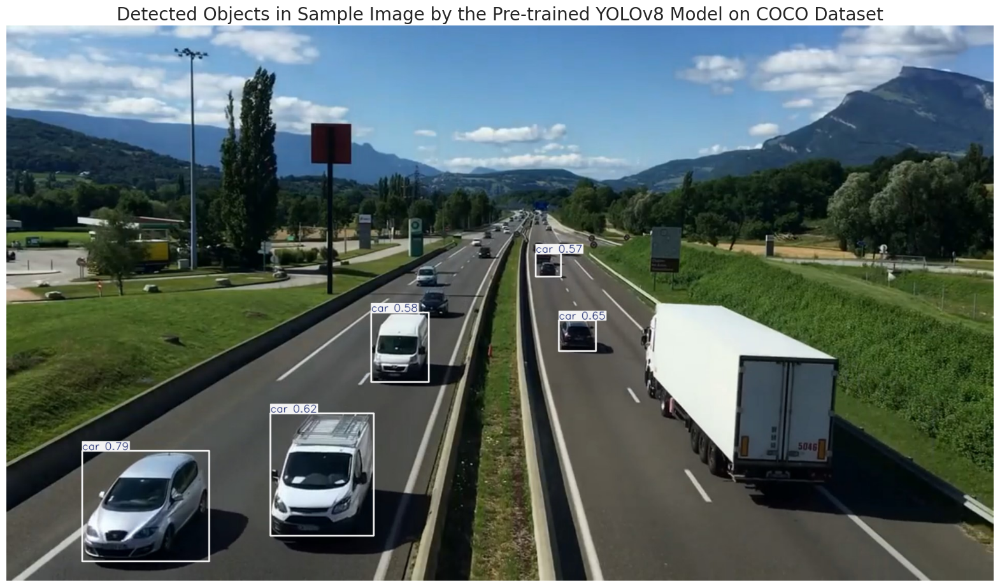

In [ ]:
# Path to the image file
image_path = '/content/extracted_folder/Vehicle_Detection_Image_Dataset/sample_image.jpg'

# Perform inference on the provided image(s)
results = model.predict(source=image_path,
                        imgsz=640,
                        verbose=False,# Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.5)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()

In [ ]:
# Define the dataset_path
dataset_path = '/content/extracted_folder/Vehicle_Detection_Image_Dataset'

# Set the path YAML file
yaml_file_path = os.path.join(dataset_path, 'data.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader = yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))

names:
- Vehicle
nc: 1
roboflow:
  license: CC BY 4.0
  project: vehicle_detection_yolov8
  url: https://universe.roboflow.com/farzad/vehicle_detection_yolov8/dataset/3
  version: 3
  workspace: farzad
train: ../train/images
val: ../valid/images



In [ ]:
# Set paths for trainig and validation images sets
trian_image_path = os.path.join(dataset_path, 'train', 'images')
validation_image_path = os.path.join(dataset_path, 'valid', 'images')

# Initialize counters for the number of images
num_trian_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_size = set()
valid_image_size = set()

# Check train images sizes and count
for filename in os.listdir(trian_image_path):
    if filename.endswith('.jpg'):
        num_trian_images += 1
        image_path = os.path.join(trian_image_path, filename)
        with Image.open(image_path) as img:
            train_image_size.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(validation_image_path):
    if filename.endswith('.jpg'):
        num_valid_images +=1
        image_path = os.path.join(validation_image_path, filename)
        with Image.open(image_path) as img:
            valid_image_size.add(img.size)

# Print the resutls
print(f"Number of training images:, {num_trian_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_size) == 1:
    print(f"All training images have the same size: {train_image_size.pop()}")
else:
    print("Training images have verying sizes.")

# Check if all images is validation set have same size
if len(valid_image_size) == 1:
    print(f"All validation images have the same size: {valid_image_size.pop()}")

else:
    print("Validation images have verying sizes")

Number of training images:, 536
Number of validation images: 90
All training images have the same size: (640, 640)
All validation images have the same size: (640, 640)


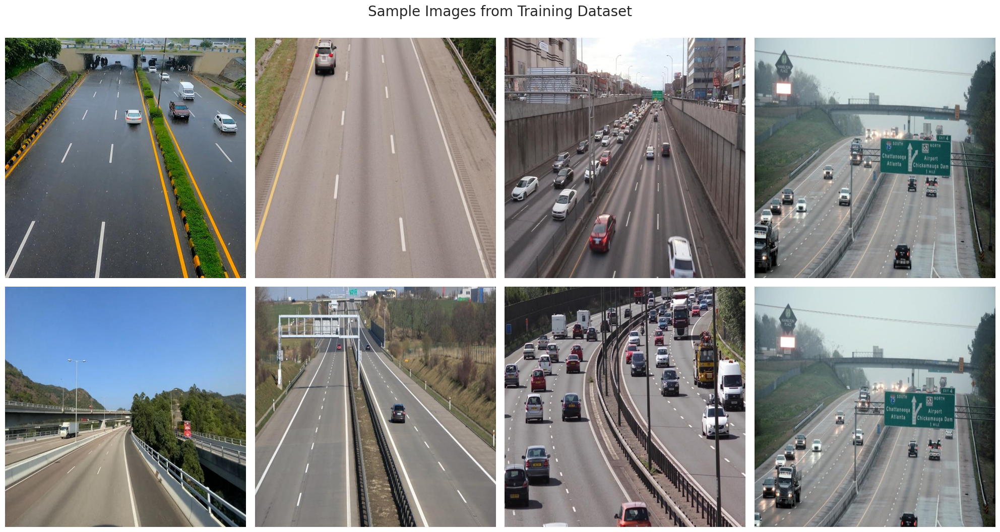

In [ ]:
# List all jpg images in the directory

image_files = [file for file in os.listdir(trian_image_path) if file.endswith('.jpg')]

# Select 8 images as eqal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 8)]

# Create a 2x4 subplot
fig,axes = plt.subplots(2,4,figsize=(20,11))

# Display each of the selected images
for ax, img_file in zip(axes.ravel(), selected_images):
    img_path =os.path.join(trian_image_path, img_file)
    image = Image.open(img_path)
    ax.imshow(image)
    ax.axis('off')

plt.suptitle('Sample Images from Training Dataset',fontsize=20)
plt.tight_layout()
plt.show()

In [ ]:
import torch
print(torch.cuda.is_available())  # Should return True if GPU is enabled

False


In [10]:
results = model.train(
    data=yaml_file_path,
    epochs=20,  # Reduced to 20 epochs
    imgsz=640,
    device='cpu',  # Use 'cpu' if no GPU is available, or '0' for the first GPU
    patience=20,  # Optional: Adjust patience for early stopping
    batch=32,
    optimizer='auto',
    lr0=0.0001,
    lrf=0.1,
    dropout=0.1
)


Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/extracted_folder/Vehicle_Detection_Image_Dataset/data.yaml, epochs=20, time=None, patience=20, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_lab

100%|██████████| 755k/755k [00:00<00:00, 15.9MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/extracted_folder/Vehicle_Detection_Image_Dataset/train/labels... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:00<00:00, 1494.32it/s]

train: New cache created: /content/extracted_folder/Vehicle_Detection_Image_Dataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/extracted_folder/Vehicle_Detection_Image_Dataset/valid/labels... 90 images, 0 backgrounds, 0 corrupt: 100%|██████████| 90/90 [00:00<00:00, 1723.63it/s]

val: New cache created: /content/extracted_folder/Vehicle_Detection_Image_Dataset/valid/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20         0G      2.311      2.797      1.781        362        640: 100%|██████████| 17/17 [10:37<00:00, 37.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:35<00:00, 17.66s/it]

                   all         90        937    0.00415       0.12    0.00315    0.00109



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20         0G      1.513      1.266      1.191        345        640: 100%|██████████| 17/17 [10:11<00:00, 35.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:37<00:00, 18.63s/it]

                   all         90        937    0.00615      0.177    0.00507    0.00215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20         0G      1.294     0.9851      1.069        376        640: 100%|██████████| 17/17 [10:00<00:00, 35.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:36<00:00, 18.49s/it]

                   all         90        937      0.871      0.401      0.528       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20         0G      1.189     0.8666      1.023        367        640: 100%|██████████| 17/17 [10:09<00:00, 35.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:39<00:00, 19.56s/it]

                   all         90        937       0.82      0.795      0.864      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20         0G      1.169     0.8095      1.018        281        640: 100%|██████████| 17/17 [10:20<00:00, 36.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:37<00:00, 18.98s/it]

                   all         90        937      0.843       0.84      0.917      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20         0G      1.151     0.8086      1.001        289        640: 100%|██████████| 17/17 [10:14<00:00, 36.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:38<00:00, 19.35s/it]

                   all         90        937      0.847      0.893       0.93      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20         0G      1.125     0.7714     0.9989        450        640: 100%|██████████| 17/17 [10:06<00:00, 35.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:37<00:00, 18.74s/it]

                   all         90        937      0.812      0.919      0.902      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20         0G      1.126     0.7641     0.9998        475        640: 100%|██████████| 17/17 [10:10<00:00, 35.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:40<00:00, 20.32s/it]

                   all         90        937      0.873       0.91      0.954      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20         0G      1.099     0.7043     0.9931        279        640: 100%|██████████| 17/17 [10:06<00:00, 35.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:41<00:00, 20.96s/it]

                   all         90        937      0.882      0.919      0.951      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20         0G      1.083     0.6977     0.9765        329        640: 100%|██████████| 17/17 [10:07<00:00, 35.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:38<00:00, 19.28s/it]

                   all         90        937      0.862      0.909      0.948       0.67


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20         0G      1.059     0.7278     0.9797        260        640: 100%|██████████| 17/17 [09:41<00:00, 34.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:38<00:00, 19.46s/it]

                   all         90        937      0.904        0.9      0.963      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20         0G      1.045     0.6674     0.9652        240        640: 100%|██████████| 17/17 [09:37<00:00, 33.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:38<00:00, 19.26s/it]

                   all         90        937      0.898      0.917      0.968       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20         0G      1.046     0.6492     0.9751        221        640: 100%|██████████| 17/17 [09:42<00:00, 34.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:39<00:00, 19.88s/it]

                   all         90        937      0.892      0.908      0.958      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20         0G      1.035     0.6196     0.9597        211        640: 100%|██████████| 17/17 [09:43<00:00, 34.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:43<00:00, 21.94s/it]

                   all         90        937      0.874      0.924      0.957      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20         0G      1.028       0.61     0.9595        215        640: 100%|██████████| 17/17 [09:35<00:00, 33.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:35<00:00, 17.65s/it]

                   all         90        937      0.899      0.917      0.964      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20         0G      1.002     0.5996     0.9563        199        640: 100%|██████████| 17/17 [09:29<00:00, 33.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:32<00:00, 16.42s/it]

                   all         90        937      0.869       0.91      0.941      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20         0G      1.006     0.5897     0.9618        203        640: 100%|██████████| 17/17 [09:32<00:00, 33.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:38<00:00, 19.47s/it]

                   all         90        937      0.902      0.909      0.967      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20         0G     0.9954     0.5754     0.9506        233        640: 100%|██████████| 17/17 [09:41<00:00, 34.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:39<00:00, 19.57s/it]

                   all         90        937      0.887       0.92       0.96      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20         0G     0.9898     0.5646     0.9525        257        640: 100%|██████████| 17/17 [09:39<00:00, 34.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:38<00:00, 19.48s/it]

                   all         90        937      0.899      0.923      0.972      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20         0G     0.9797     0.5564     0.9518        230        640: 100%|██████████| 17/17 [09:41<00:00, 34.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:36<00:00, 18.33s/it]

                   all         90        937      0.916      0.901      0.965      0.706



20 epochs completed in 3.528 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:31<00:00, 15.62s/it]


                   all         90        937      0.916      0.902      0.965      0.706
Speed: 9.0ms preprocess, 322.5ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/train


In [11]:
# Define the path to the Directory
post_training_files_path ='/content/runs/detect/train'

# list the files in the directory
!ls {post_training_files_path}

args.yaml					   PR_curve.png        train_batch1.jpg
confusion_matrix_normalized.png			   R_curve.png	       train_batch2.jpg
confusion_matrix.png				   results.csv	       val_batch0_labels.jpg
events.out.tfevents.1731898754.6b1137575b3d.214.0  results.png	       val_batch0_pred.jpg
F1_curve.png					   train_batch0.jpg    val_batch1_labels.jpg
labels_correlogram.jpg				   train_batch170.jpg  val_batch1_pred.jpg
labels.jpg					   train_batch171.jpg  weights
P_curve.png					   train_batch172.jpg


In [12]:
# Construct the path to the best model weights file using os.path.join
best_model_path = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model = YOLO(best_model_path)

# Validate the best model using the validation set with default parameters
metrics = best_model.val(split='val')

Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/extracted_folder/Vehicle_Detection_Image_Dataset/valid/labels.cache... 90 images, 0 backgrounds, 0 corrupt: 100%|██████████| 90/90 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:29<00:00,  4.85s/it]


                   all         90        937      0.916      0.902      0.965      0.706
Speed: 3.5ms preprocess, 302.8ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/val


In [13]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='#141140', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='orangered', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

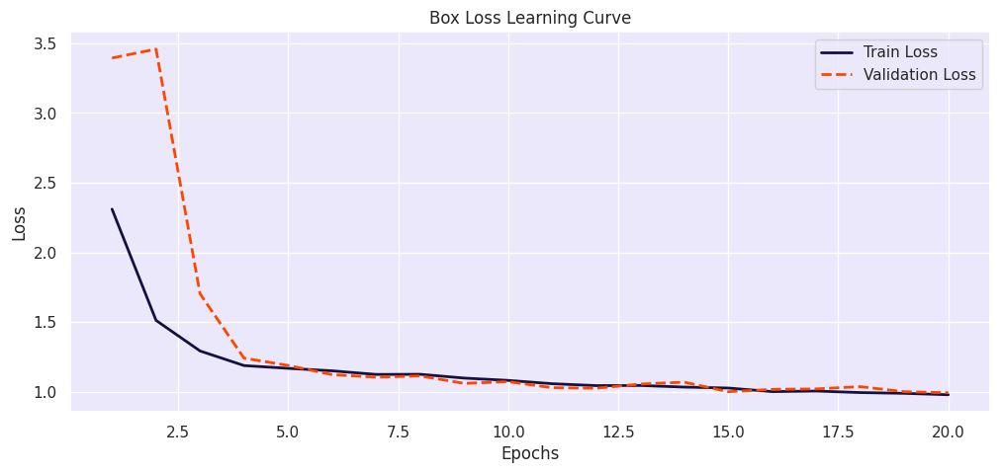

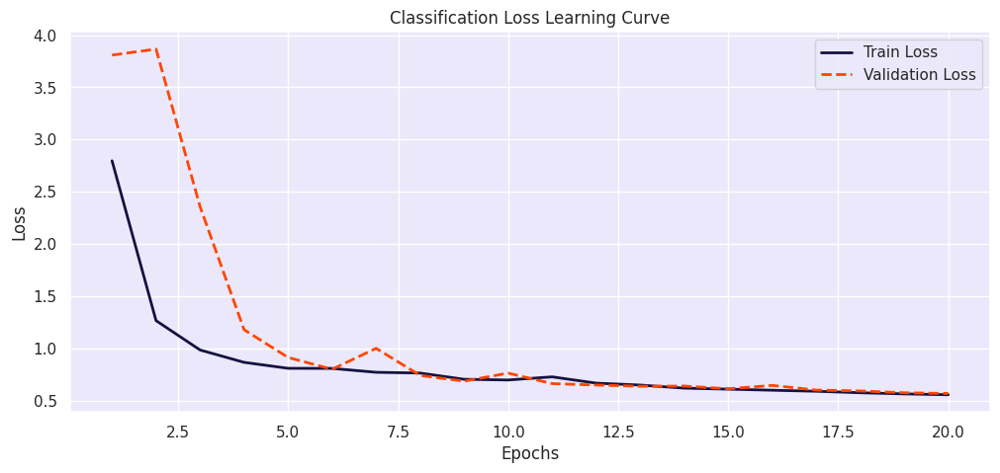

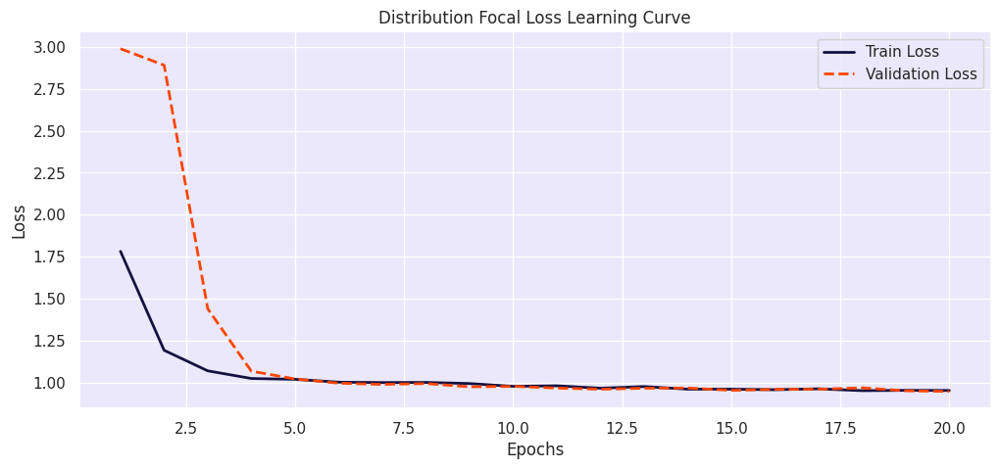

In [14]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')


image 1/1 /content/extracted_folder/Vehicle_Detection_Image_Dataset/valid/images/16_mp4-1_jpg.rf.3493f4b7618e207609847857a20dbaff.jpg: 640x640 14 Vehicles, 263.6ms
Speed: 3.7ms preprocess, 263.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/extracted_folder/Vehicle_Detection_Image_Dataset/valid/images/8_mp4-14_jpg.rf.e15e22de0316fce6d319640eae7a04c3.jpg: 640x640 15 Vehicles, 252.3ms
Speed: 4.5ms preprocess, 252.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/extracted_folder/Vehicle_Detection_Image_Dataset/valid/images/10_mp4-9_jpg.rf.72a35ba2f76343afc7a101e720dbbb81.jpg: 640x640 22 Vehicles, 276.4ms
Speed: 3.4ms preprocess, 276.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/extracted_folder/Vehicle_Detection_Image_Dataset/valid/images/3_mp4-17_jpg.rf.fdfd6a4ddf7c5f516a940b2452857d67.jpg: 640x640 1 Vehicle, 241.7ms
Speed: 3.4ms preprocess, 241.7ms inference, 1.0m

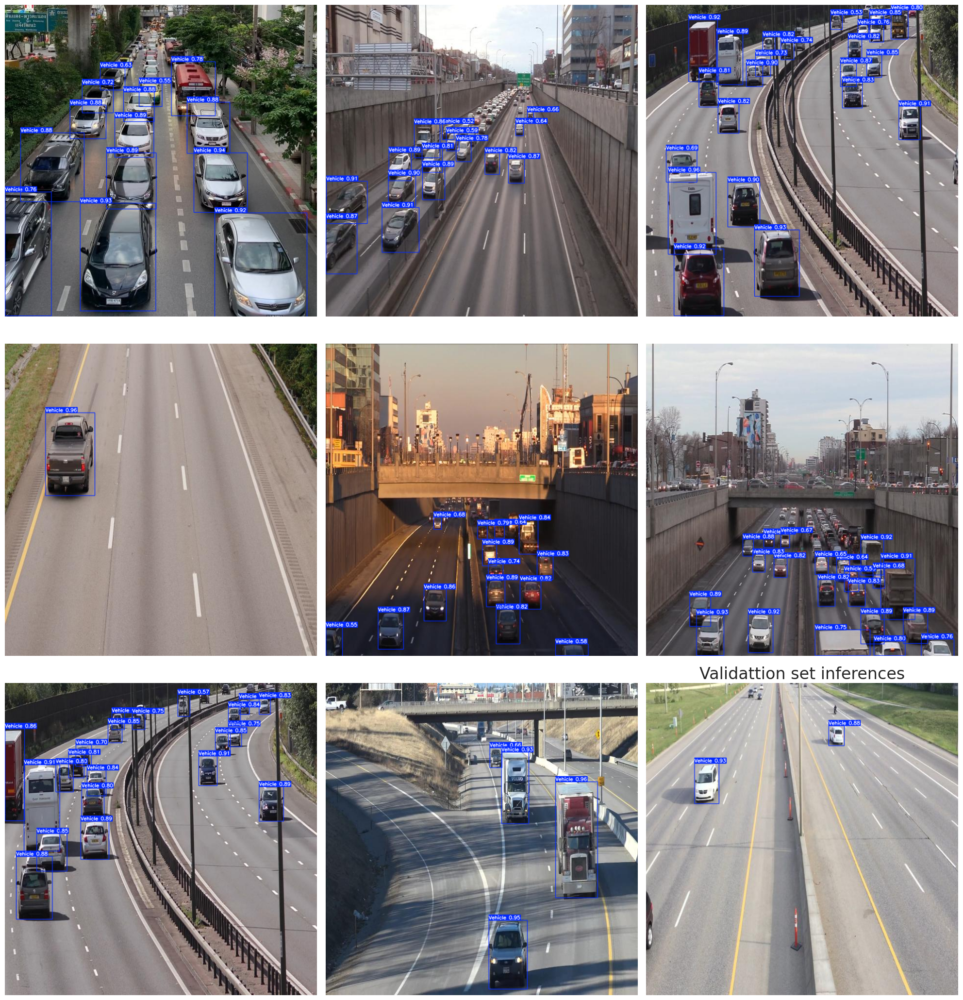

In [15]:
# Interface on validationset
valid_image_path = os.path.join(dataset_path, 'valid','images')

# list all jpg images in the directory
image_files = [file for file in os.listdir(valid_image_path) if file.endswith('.jpg')]

# select 9 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 9)]

# Initailize the subplot
fig, axes = plt.subplots(3,3,figsize=(20,21))
plt.title('Validattion set inferences', fontsize=24)


# Perform inferences on each selected image and display it
for i, ax, in enumerate(axes.flatten()):
    image_path = os.path.join(valid_image_path, selected_images[i])
    results = best_model.predict(source = image_path, imgsz = 640, conf=0.5)
    annotated_image = results[0].plot(line_width=1)
    annotated_image_rgb =cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    ax.imshow(annotated_image_rgb)
    ax.axis('off')

plt.tight_layout()
plt.show()


image 1/1 /content/extracted_folder/Vehicle_Detection_Image_Dataset/sample_image.jpg: 384x640 5 Vehicles, 245.6ms
Speed: 5.9ms preprocess, 245.6ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


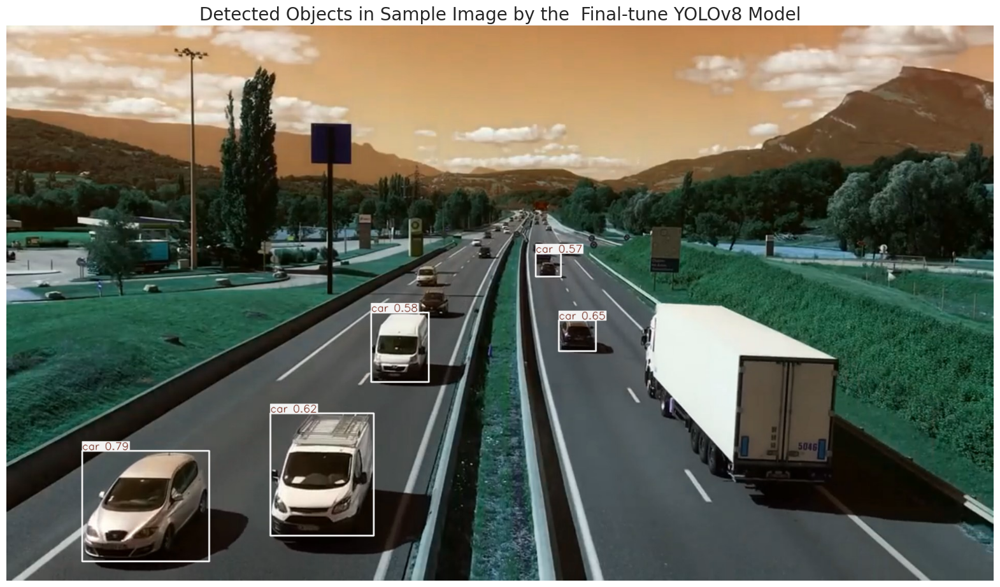

In [16]:
sample_image_path = '/content/extracted_folder/Vehicle_Detection_Image_Dataset/sample_image.jpg'
# Perform inference on the provided image using best model
results = best_model.predict(source=sample_image_path, imgsz=640,conf=0.7)

# Annotate and convert image to numpy array
smaple_image = results[0].plot(line_width=2)

# convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the  Final-tune YOLOv8 Model', fontsize=20)
plt.axis('off')
plt.show()

In [17]:
# Define the path to the sample video in the dataset
dataset_video_path = '/content/extracted_folder/Vehicle_Detection_Image_Dataset/sample_video.mp4'

# Define the destination path in the working directory
video_path = '/content/runs/sample_video.mp4'

# Copy the video file from its original location in the dataset to the current working directory in Kaggle for further processing
shutil.copyfile(dataset_video_path, video_path)

# Initiate vehicle detection on the sample video using the best performing model and save the output
best_model.predict(source=video_path, save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/601) /content/runs/sample_video.mp4: 384x640 3 Vehicles, 307.0ms
video 1/1 (frame 2/601) /content/runs/sample_video.mp4: 384x640 3 Vehicles, 185.6ms
video 1/1 (frame 3/601) /content/runs/sample_video.mp4: 384x640 3 Vehicles, 159.7ms
video 1/1 (frame 4/601) /content/runs/sample_video.mp4: 384x640 4 Vehicles, 155.1ms
video 1/1 (frame 5/601) /content/runs/sample_video.mp4: 384x640 4 Vehicles, 168.4ms
video 1/1 (frame 6/601) /content/run

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Vehicle'}
 obb: None
 orig_img: array([[[252, 245, 242],
         [252, 245, 242],
         [252, 245, 242],
         ...,
         [210, 184, 166],
         [210, 184, 166],
         [210, 184, 166]],
 
        [[252, 245, 242],
         [252, 245, 242],
         [252, 245, 242],
         ...,
         [210, 184, 166],
         [210, 184, 166],
         [210, 184, 166]],
 
        [[254, 246, 241],
         [254, 246, 241],
         [254, 246, 241],
         ...,
         [210, 184, 166],
         [210, 184, 166],
         [210, 184, 166]],
 
        ...,
 
        [[ 94, 104, 103],
         [ 96, 106, 105],
         [101, 111, 110],
         ...,
         [ 94, 106, 111],
         [ 95, 107, 112],
         [ 97, 109, 114]],
 
        [[ 98, 108, 107],
         [103, 113, 112],
         [100, 110, 109],
         ...,
         [ 95, 10

In [24]:
# Convert .avi video to .mp4
!ffmpeg -y -loglevel panic -i /content/runs/detect/predict/sample_video.avi processed_sample_video.mp4

# Embed and display the .mp4 video
from IPython.display import Video

Video("/content/processed_sample_video.mp4", embed=True, width=960)


In [26]:
import cv2
import numpy as np

# Define the threshold for considering traffic as heavy
heavy_traffic_threshold = 10

# Define the vertices for the quadrilaterals
vertices1 = np.array([(465, 350), (609, 350), (510, 630), (2, 630)], dtype=np.int32)
vertices2 = np.array([(678, 350), (815, 350), (1203, 630), (743, 630)], dtype=np.int32)

# Define the vertical range for the slice and lane threshold
x1, x2 = 325, 635
lane_threshold = 609

# Define the positions for the text annotations on the image
text_position_left_lane = (10, 50)
text_position_right_lane = (820, 50)
intensity_position_left_lane = (10, 100)
intensity_position_right_lane = (820, 100)

# Define font, scale, and colors for the annotations
font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 1
font_color = (255, 255, 255)    # White color for text
background_color = (0, 0, 255)  # Red background for text

# Open the video
cap = cv2.VideoCapture('/content/runs/sample_video.mp4')  # Ensure the input path is correct

# Check if the video file was opened successfully
if not cap.isOpened():
    raise IOError("Error opening video file. Check the file path!")

# Get the frame width and height
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('traffic_density_analysis.avi', fourcc, 20.0, (frame_width, frame_height))

# Read until video is completed
while cap.isOpened():
    ret, frame = cap.read()
    if ret:
        # Create a copy of the original frame to modify
        detection_frame = frame.copy()

        # Black out the regions outside the specified vertical range
        detection_frame[:x1, :] = 0  # Black out from top to x1
        detection_frame[x2:, :] = 0  # Black out from x2 to the bottom of the frame

        # Perform inference on the modified frame
        results = best_model.predict(detection_frame, imgsz=640, conf=0.4)
        processed_frame = results[0].plot(line_width=1)

        # Restore the original top and bottom parts of the frame
        processed_frame[:x1, :] = frame[:x1, :].copy()
        processed_frame[x2:, :] = frame[x2:, :].copy()

        # Draw the quadrilaterals on the processed frame
        cv2.polylines(processed_frame, [vertices1], isClosed=True, color=(0, 255, 0), thickness=2)
        cv2.polylines(processed_frame, [vertices2], isClosed=True, color=(255, 0, 0), thickness=2)

        # Retrieve the bounding boxes from the results
        bounding_boxes = results[0].boxes

        # Initialize counters for vehicles in each lane
        vehicles_in_left_lane = 0
        vehicles_in_right_lane = 0

        # Loop through each bounding box to count vehicles in each lane
        for box in bounding_boxes.xyxy:
            # Check if the vehicle is in the left lane based on the x-coordinate of the bounding box
            if box[0] < lane_threshold:
                vehicles_in_left_lane += 1
            else:
                vehicles_in_right_lane += 1

        # Determine the traffic intensity for the left lane
        traffic_intensity_left = "Heavy" if vehicles_in_left_lane > heavy_traffic_threshold else "Smooth"
        # Determine the traffic intensity for the right lane
        traffic_intensity_right = "Heavy" if vehicles_in_right_lane > heavy_traffic_threshold else "Smooth"

        # Add a background rectangle for the left lane vehicle count
        cv2.rectangle(processed_frame, (text_position_left_lane[0]-10, text_position_left_lane[1] - 25),
                      (text_position_left_lane[0] + 460, text_position_left_lane[1] + 10), background_color, -1)

        # Add the vehicle count text on top of the rectangle for the left lane
        cv2.putText(processed_frame, f'Vehicles in Left Lane: {vehicles_in_left_lane}', text_position_left_lane,
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Add a background rectangle for the left lane traffic intensity
        cv2.rectangle(processed_frame, (intensity_position_left_lane[0]-10, intensity_position_left_lane[1] - 25),
                      (intensity_position_left_lane[0] + 460, intensity_position_left_lane[1] + 10), background_color, -1)

        # Add the traffic intensity text on top of the rectangle for the left lane
        cv2.putText(processed_frame, f'Traffic Intensity: {traffic_intensity_left}', intensity_position_left_lane,
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Add a background rectangle for the right lane vehicle count
        cv2.rectangle(processed_frame, (text_position_right_lane[0]-10, text_position_right_lane[1] - 25),
                      (text_position_right_lane[0] + 460, text_position_right_lane[1] + 10), background_color, -1)

        # Add the vehicle count text on top of the rectangle for the right lane
        cv2.putText(processed_frame, f'Vehicles in Right Lane: {vehicles_in_right_lane}', text_position_right_lane,
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Add a background rectangle for the right lane traffic intensity
        cv2.rectangle(processed_frame, (intensity_position_right_lane[0]-10, intensity_position_right_lane[1] - 25),
                      (intensity_position_right_lane[0] + 460, intensity_position_right_lane[1] + 10), background_color, -1)

        # Add the traffic intensity text on top of the rectangle for the right lane
        cv2.putText(processed_frame, f'Traffic Intensity: {traffic_intensity_right}', intensity_position_right_lane,
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Write the processed frame to the output video
        out.write(processed_frame)
    else:
        break

# Release the video capture and video write objects
cap.release()
out.release()



0: 384x640 (no detections), 176.1ms
Speed: 3.4ms preprocess, 176.1ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 174.4ms
Speed: 2.8ms preprocess, 174.4ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 167.3ms
Speed: 3.9ms preprocess, 167.3ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 173.6ms
Speed: 2.8ms preprocess, 173.6ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 156.0ms
Speed: 3.6ms preprocess, 156.0ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 183.9ms
Speed: 6.3ms preprocess, 183.9ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 163.5ms
Speed: 4.8ms preprocess, 163.5ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 150.9ms
Speed: 3.8ms prepr

In [27]:
# Convert the .avi video generated by our traffic density estimation app to .mp4 format for compatibility with notebook display
!ffmpeg -y -loglevel panic -i /content/traffic_density_analysis.avi traffic_density_analysis.mp4

# Embed and display the processed sample video within the notebook
Video("traffic_density_analysis.mp4", embed=True, width=960)